In [17]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from torch.utils.data import DataLoader
import torch

# import sys
# print(sys.executable)
# print(sys.path)
%load_ext autoreload
%autoreload 2

from ds_utils import utils as ds_utils
from gp_models import gp_wrappers as gp_wrappers
from sys_dyn import problem_setups
from sys_dyn import nlsys_utils as nlsys_utils
from adaptive_mapper import utils as adap_utils
from adaptive_mapper import siren_map as vehicle_siren_map
from adaptive_mapper.utils import RegionMap_DS
from adaptive_mapping_tests import pipeline_setup_clean as adap_pipeline
from common.plotting_utils import AxisAdjuster

import logging
logging.getLogger().setLevel(logging.CRITICAL)


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Siren with posterior update rule training demo

### Visualize initial environment mode distribution

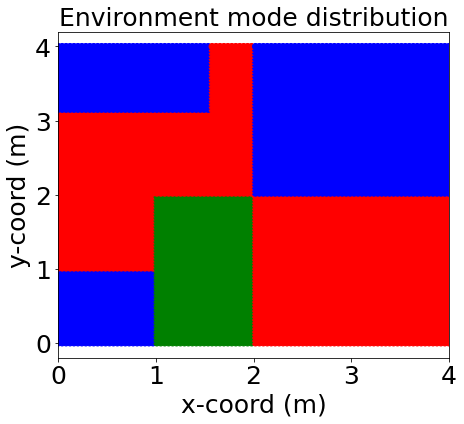

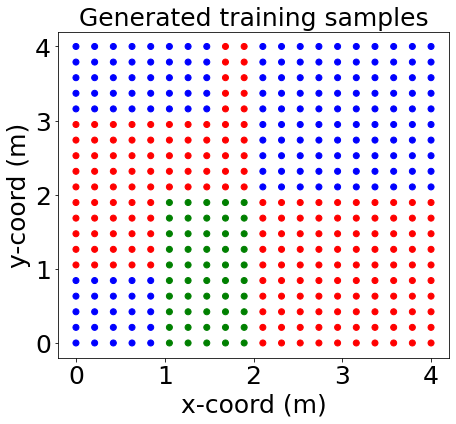

In [65]:
# Create and visualize initial environment mode distribution
init_box_inst = adap_utils.get_testmap_tensor_initial(viz=False)
init_box_inst.visualize_env(fine_ctrl=100)

# Generate siren training samples
train_samples = init_box_inst.gen_test_samples(fine_ctrl=20)
mode_deltas, sample_labels, train_samples = init_box_inst.get_mode_at_points(train_samples, enforce_satisfaction=True)
X_train, y_train = train_samples, mode_deltas
test_samples = init_box_inst.gen_test_samples(fine_ctrl=100)
mode_deltas, sample_labels, test_samples = init_box_inst.get_mode_at_points(test_samples, enforce_satisfaction=True)
X_test, y_test = test_samples, mode_deltas

# Visualize training dataset
fig, ax = plt.subplots(1, 1, figsize=(7, 6))
ax.scatter(X_train[0, :], X_train[1, :], c=np.array(vehicle_siren_map.one_hot_to_categorical(y_train, 3)).squeeze(),
           cmap=ListedColormap(['r', 'g', 'b']),
           vmin=0, vmax=2)
AxisAdjuster(labelsize=25).adjust_ax_object(ax=ax,
                                            title_text="Generated training samples",
                                            xlabel_text='x-coord (m)',
                                            ylabel_text='y-coord (m)', set_equal=False, skip_legend=True, legend_loc="lower right")
plt.show()

# Make y train soft (more representative of true samples we'll collect while operating the system with a feedback controller)
temp = np.full(y_train.shape, 0.1)
temp[y_train == 1] = 0.8  # Replace the original positions with 0.8 where data has 1s
y_train = temp

### Train on soft labels from initial mode distribution

Step 0, Total loss 782.492550
Step 30, Total loss 747.702672
Step 60, Total loss 745.410683
Step 90, Total loss 744.961676
Step 120, Total loss 744.842150
Step 150, Total loss 744.793721
Step 180, Total loss 744.770045
Step 210, Total loss 744.757236
Step 240, Total loss 744.749703
PRED ACC 0.9697; PRED MSE 0.044913400433335526


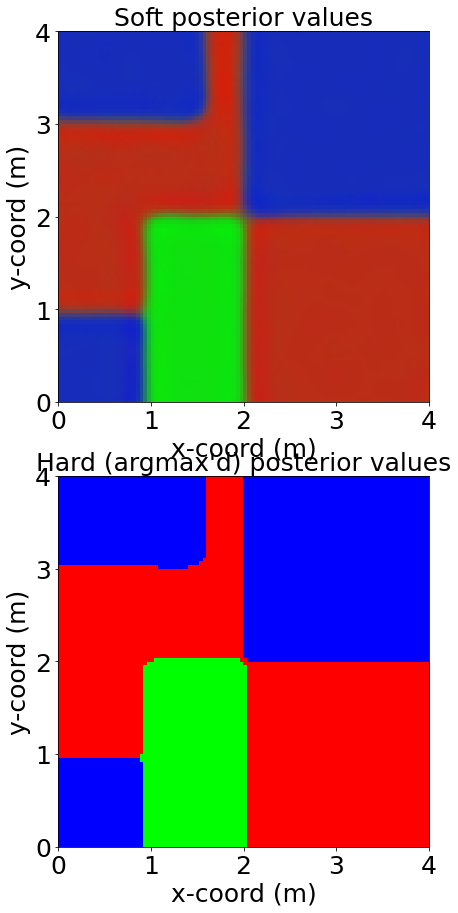

In [66]:
# Init siren instance to be trained on generated dataset.
siren_inst = vehicle_siren_map.init_siren_inst(omega_param=5.)

# Create train dataloader
map_ds = RegionMap_DS(x=X_train.T, y=y_train.T, inp_dim=X_train.shape[0], num_classes=y_train.shape[0])
train_dataloader = DataLoader(map_ds, batch_size=X_train.shape[1], pin_memory=True, num_workers=0)

# Run training loop
siren_inst.siren_training_loop(train_dl=train_dataloader,
                               total_steps=250, num_mse=0, num_ce=3, steps_til_summary=10)

# Test predictions
predictor_inst = vehicle_siren_map.SirenPredictor(siren_inst=siren_inst)
predictor_inst.test_model_preds_img(X_test, y_test, test_ds_fine_ctrl=100, viz_samples_on_test_pred=False)

plt.show()

### Update environment mode distribution
It is clear that the mode distribution has changed in 2 places. The blue box mode in the top right has become green. And the green box mode in the lower middle has become blue.

<AxesSubplot:title={'center':'Environment mode distribution'}, xlabel='x-coord (m)', ylabel='y-coord (m)'>

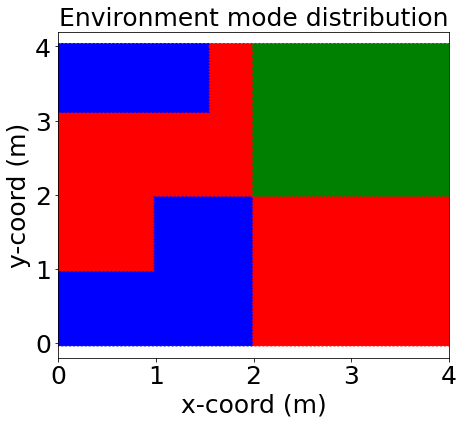

In [67]:
final_box_inst = adap_utils.get_testmap_tensor_adaptive2(viz=False)
final_box_inst.visualize_env(fine_ctrl=100)

### Create makeshift alpha map that differs in the two modified areas of the environment
The alpha map has been set up such that the top right box mode distribution change should be adapted to faster (with our proposed likelihood-prior trade-off algorithm) when compared against the lower middle box mode distribution change.

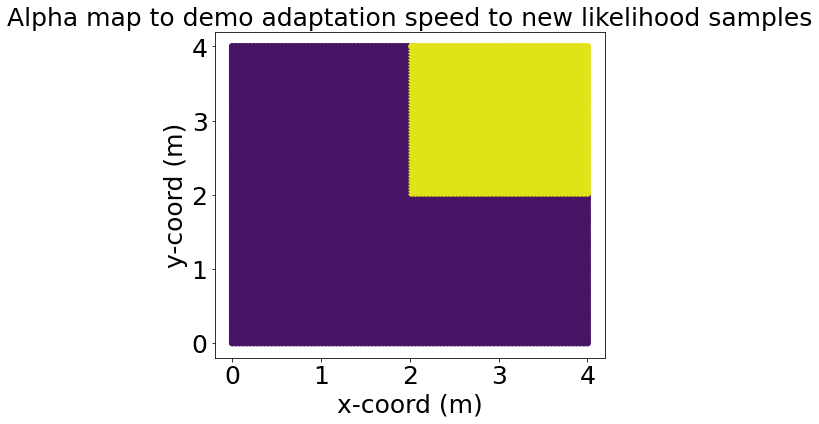

In [68]:
placeholder_samples = final_box_inst.gen_test_samples(fine_ctrl=100)  
condition = np.array([2, 2])
satisfying_idxs = np.where(np.all(placeholder_samples >= condition[:, None], axis=0))[0]
alpha_map = np.ones((placeholder_samples.shape[1])) * 0.05  # Mostly slow adaptation across workspace
alpha_map[satisfying_idxs] = 0.95  # Faster adaptation in the top right of workspace

fig, ax = plt.subplots(1, 1, figsize=(7, 6))
ax.scatter(placeholder_samples[0, :], placeholder_samples[1, :], c=alpha_map, cmap='viridis', vmin=0, vmax=1)
AxisAdjuster(labelsize=25).adjust_ax_object(ax=ax,
                                            title_text="Alpha map to demo adaptation speed to new likelihood samples",
                                            xlabel_text='x-coord (m)',
                                            ylabel_text='y-coord (m)', set_equal=False, skip_legend=True, legend_loc="lower right")

### Visualizing the output of the posterior update rule. 
It can be seen that the portion of the workspace with high alpha has posteriors that quickly adapted to the mode change (blue to green). However, the portion in the lower middle doesn't show as quick adaptation (green to blue) due to the lower value of alpha.

Note: This would be one iteration of our algorithm. The generated "posterior" labels visualized below will next be used to fine-tune the SIREN network used for mapping. This would be done with every new batch of samples obtained from the environment. In our case, a "batch" corresponds to a trajectory of collected samples as will be showcased in future cells. Since the SIREN network is not re-trained in this cell, the visualized output will always look the same across multiple runs of this cell (prior and likelihood generation remains identical).

(<Figure size 1872x1080 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Soft posterior values'}, xlabel='x-coord (m)', ylabel='y-coord (m)'>,
        <AxesSubplot:title={'center':"Hard (argmax'd) posterior values"}, xlabel='x-coord (m)', ylabel='y-coord (m)'>],
       dtype=object))

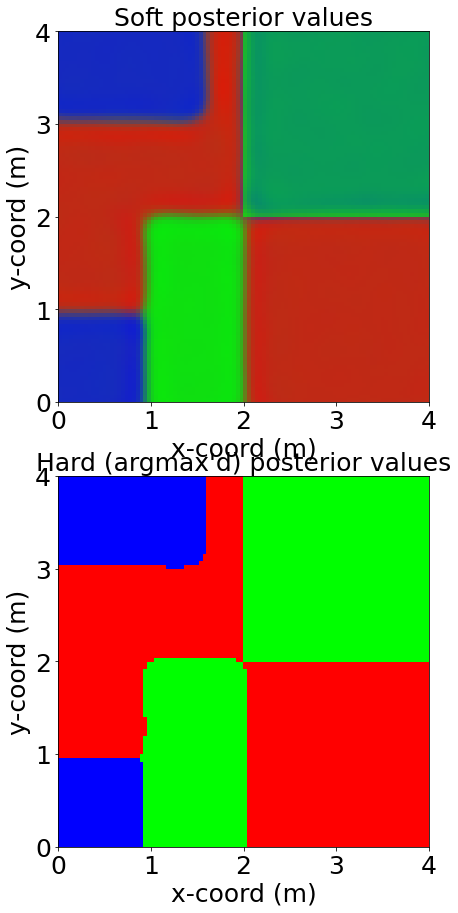

In [69]:
# Get dense ground truth mode samples for new mode distribution.
test_samples = final_box_inst.gen_test_samples(fine_ctrl=100)
new_mode_deltas, _, _ = final_box_inst.get_mode_at_points(test_samples, enforce_satisfaction=True)
y_test = new_mode_deltas

# Get predictor outputs on large dataset for previously trained model. softmaxd_op is equivalent to prior estimates in our algorithm
test_outputs, softmaxd_op, hard_test_ops, categorical_arr = predictor_inst.gen_pred_outputs(test_X=placeholder_samples)

# Make y labels soft and treat as likelihood estimates (generated from new ground truth mode distribution)
temp = np.full(y_test.shape, 0.1)
temp[y_test == 1] = 0.8 
y_test_temp = temp

# Do likelihood-prior trade-off weighted by the alpha map created in previous cell.
alpha_map = alpha_map.reshape(1, -1)
unnormd_posteriors_new = (y_test_temp ** alpha_map) * softmaxd_op.detach().numpy()
samplewise_norm_const = np.linalg.norm(unnormd_posteriors_new, ord=1, axis=0).reshape(1, -1)
labels_new = unnormd_posteriors_new / samplewise_norm_const

vehicle_siren_map.viz_quad_map_img(arr_to_viz=torch.Tensor(labels_new).T, fine_ctrl=100, samples_to_plot=None)

### Finetuning SIREN on new labels given by posterior update rule
- First cell generates 400 new uniform samples to finetune on (generated from the new mode distribution)
- Second cell generates the posterior labels via our proposed trade-off step (using the same alpha map as before)
- Third cell finetunes on these posteriors

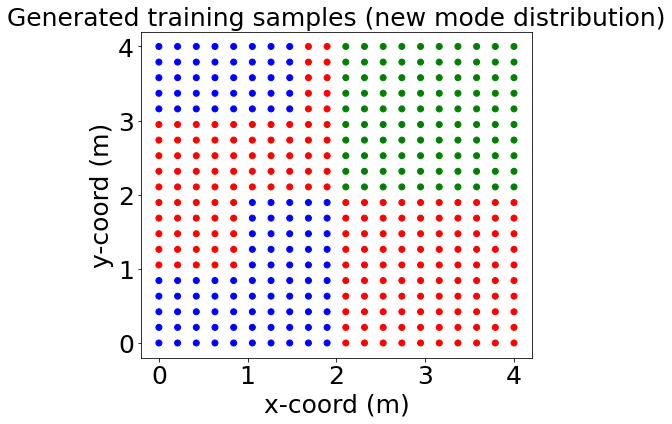

In [70]:
train_samples = final_box_inst.gen_test_samples(fine_ctrl=20)
mode_deltas, sample_labels, train_samples = final_box_inst.get_mode_at_points(train_samples, enforce_satisfaction=True)
X_train, y_train = train_samples, mode_deltas
# Visualize training dataset
fig, ax = plt.subplots(1, 1, figsize=(7, 6))
ax.scatter(X_train[0, :], X_train[1, :], c=np.array(vehicle_siren_map.one_hot_to_categorical(y_train, 3)).squeeze(),
           cmap=ListedColormap(['r', 'g', 'b']),
           vmin=0, vmax=2)
AxisAdjuster(labelsize=25).adjust_ax_object(ax=ax,
                                            title_text="Generated training samples (new mode distribution)",
                                            xlabel_text='x-coord (m)',
                                            ylabel_text='y-coord (m)', set_equal=False, skip_legend=True, legend_loc="lower right")
plt.show()

# Make y train soft
temp = np.full(y_train.shape, 0.1)
temp[y_train == 1] = 0.8  # Replace the original positions with 0.8 where data has 1s
y_train = temp

(<Figure size 1872x1080 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Soft posterior values'}, xlabel='x-coord (m)', ylabel='y-coord (m)'>,
        <AxesSubplot:title={'center':"Hard (argmax'd) posterior values"}, xlabel='x-coord (m)', ylabel='y-coord (m)'>],
       dtype=object))

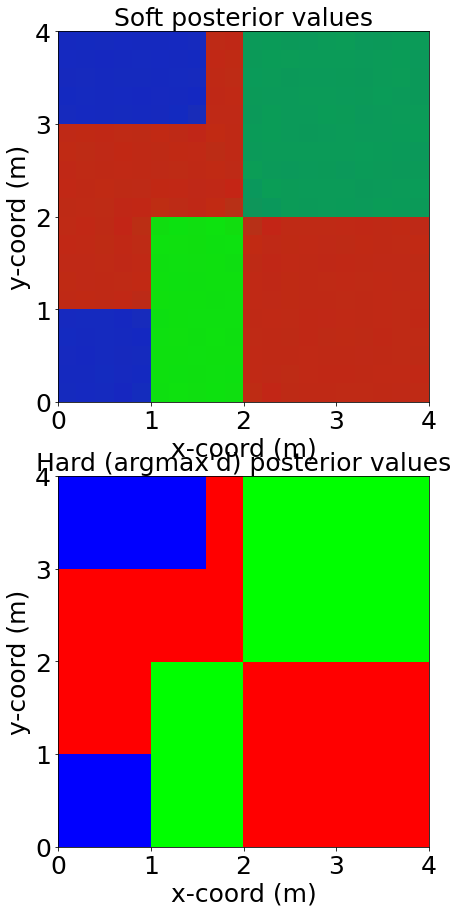

In [71]:
condition = np.array([2, 2])
satisfying_idxs = np.where(np.all(train_samples >= condition[:, None], axis=0))[0]
alpha_map = np.ones((train_samples.shape[1])) * 0.05  # Mostly slow adaptation across workspace
alpha_map[satisfying_idxs] = 0.95  # Faster adaptation in the top right of workspace
_, softmaxd_op, _, _ = predictor_inst.gen_pred_outputs(test_X=train_samples)

unnormd_posteriors_new = (y_train ** alpha_map) * softmaxd_op.detach().numpy()
samplewise_norm_const = np.linalg.norm(unnormd_posteriors_new, ord=1, axis=0).reshape(1, -1)
labels_new = unnormd_posteriors_new / samplewise_norm_const
y_train = labels_new
# NOTE: this only visualize as "continuous" because imshow is used inside viz_quad_map_img
vehicle_siren_map.viz_quad_map_img(arr_to_viz=torch.Tensor(labels_new).T, fine_ctrl=20, samples_to_plot=None)

Clearly the alpha map + finetuning with our likelihood-prior tradeoff step has allowed us to adapt quicker in the top right while not adapting (rather adapting cautiously) for the mode change in the lower middle.

Step 0, Total loss 748.687114
Step 30, Total loss 748.687023
Step 60, Total loss 748.686946
Step 90, Total loss 748.686879
Step 120, Total loss 748.686822
PRED ACC 0.8479; PRED MSE 0.12283008956864448


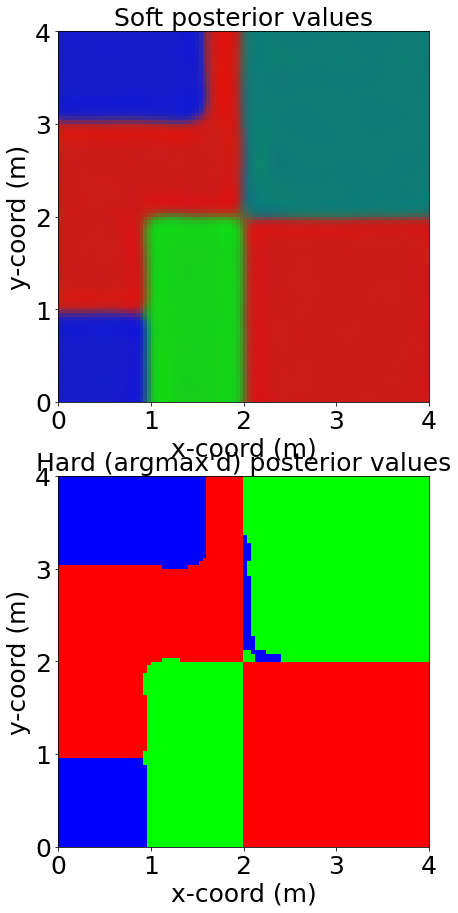

In [73]:
# Create train dataloader
map_ds = RegionMap_DS(x=X_train.T, y=y_train.T, inp_dim=X_train.shape[0], num_classes=y_train.shape[0])
train_dataloader = DataLoader(map_ds, batch_size=X_train.shape[1], pin_memory=True, num_workers=0)

# Run training loop
siren_inst.siren_training_loop(train_dl=train_dataloader,
                            total_steps=150, num_mse=0, num_ce=3, steps_til_summary=10)

# Test predictions
predictor_inst = vehicle_siren_map.SirenPredictor(siren_inst=siren_inst)
# predictor_inst.test_model_preds(X_test, y_test, colour_overrides=['r', 'g', 'b'])
predictor_inst.test_model_preds_img(X_test, y_test, test_ds_fine_ctrl=100, viz_samples_on_test_pred=False, fig_save_name='test')

plt.show()

# Closed-loop control with adaptive mapping demo

## GP Training
- If training from scratch, you can save the model to a file by changing model_save_file to a value other than None.
- If loading a model you trained previously (res_1d_poly_gp.pkl has already been provided by default), change model_load_file to a value other than None.

In [6]:
model_save_file = None  # Training from scratch gets priority
model_load_file = "res_1d_poly_gp"

if model_save_file is None:
    assert model_load_file is not None
    
if model_save_file is not None:
    save_to_file, load_from_file = True, False
    TRAIN_GP_FROM_SCRATCH = True
elif model_load_file is not None:
    save_to_file, load_from_file = False, True
    TRAIN_GP_FROM_SCRATCH = False
else:
    save_to_file, load_from_file = False, False
    TRAIN_GP_FROM_SCRATCH = True  # If neither argument is passed, just train from scratch temporarily for this notebook.

LOADING GP MODELS AND LIKELIHOODS FROM FILE: res_1d_poly_gp.pkl


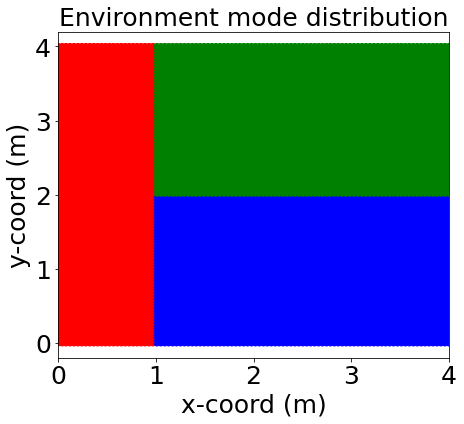

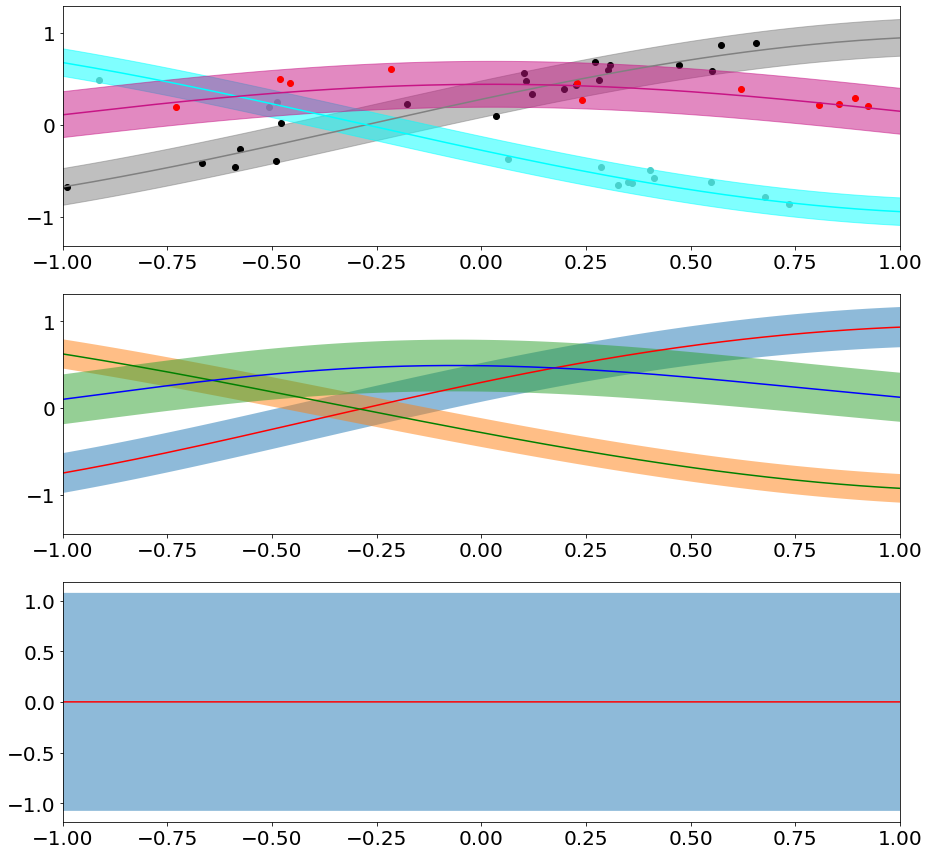

In [7]:
if TRAIN_GP_FROM_SCRATCH:
    
    # GENERATE DATASET FOR GP TRAINING.
    velocity_override = 5
    setup_inst = problem_setups.quad_2d_sys_1d_inp_res(velocity_limit_override=velocity_override)
    box_env_inst = setup_inst["box_env_inst"]
    s_start_limit, s_end_limit = setup_inst["x_start_limit"], setup_inst["x_end_limit"]
    gp_input_mask = setup_inst["gp_input_mask"]
    delta_input_mask = setup_inst["delta_input_mask"]
    n_u = setup_inst["n_u"]
    num_samples = 200
    viz = True
    scale_poly = 2
    noise_std_devs = [0.1, 0.075, 0.125]

    poly_coeffs = [np.array([-5.86024026e-05, -9.09922063e-05,  4.17839279e-03,  5.46798390e-03, -8.74124645e-02, -7.68274967e-02,  4.89430419e-01,  1.38718238e-01]),
                -np.array([-5.86024026e-05, -9.09922063e-05,  4.17839279e-03,  5.46798390e-03, -8.74124645e-02, -7.68274967e-02,  4.89430419e-01,  1.38718238e-01]),
                np.array([3.48167424e-05,  2.29572396e-05, -1.92304178e-03, -5.29264039e-04,  3.35480619e-02,  5.82899495e-04, -1.87669116e-01,  9.30450457e-03,  2.20458632e-01])]

    ds_inst_in = ds_utils.test_1d_op_1d_inp_poly(box_env_inst=box_env_inst, poly_coeffs=poly_coeffs,
                                                start_limit=setup_inst["gpinp_subset_lim_lb"], end_limit=setup_inst["gpinp_subset_lim_ub"], gp_input_mask=gp_input_mask,
                                                delta_input_mask=delta_input_mask, n_u=n_u, num_points=num_samples,
                                                noise_vars=[noise_std_dev ** 2 for noise_std_dev in noise_std_devs],
                                                no_viz=not viz, fineness_param=(200,), scale_poly=scale_poly)
    
    # TRAINED PIECEWISE AND GLOBAL GPs    
    trained_gp_viz = True
    train_verbose = True
    return_error_attrs = False
    seed = None
    fineness_param = (75,)
    num_iter = 350
    true_only = False

    pw_gp_wrapped, global_gp_wrapped, gp_ds_inst = gp_wrappers.train_global_n_pw(ds_inst_in, box_env_inst=box_env_inst, viz=trained_gp_viz, verbose=train_verbose, return_error_attrs=return_error_attrs,
                                                                                seed=seed, fineness_param=fineness_param, num_iter=num_iter, true_only=true_only,
                                                                                terminate_by_change=False, save_to_file=save_to_file, load_from_file=load_from_file,
                                                                                file_save_name=model_save_file, file_load_name=model_load_file)
else:
    trained_gp_viz = True
    train_verbose = True
    return_error_attrs = False
    seed = None
    fineness_param = (75,)
    num_iter = 350
    true_only = False
    
    velocity_override = 5
    setup_inst = problem_setups.quad_2d_sys_1d_inp_res(velocity_limit_override=velocity_override)
    box_env_inst = setup_inst["box_env_inst"]

    pw_gp_wrapped, global_gp_wrapped, gp_ds_inst = gp_wrappers.train_global_n_pw(ds_inst_in=None, box_env_inst=box_env_inst, viz=trained_gp_viz, verbose=train_verbose, return_error_attrs=return_error_attrs,
                                                                                seed=seed, fineness_param=fineness_param, num_iter=num_iter, true_only=true_only,
                                                                                terminate_by_change=False, save_to_file=save_to_file, load_from_file=load_from_file,
                                                                                file_save_name=model_save_file, file_load_name=model_load_file)

## Baseline demo (fixed discrete variables across horizon)

tensor([[-0.0063],
        [ 0.0461]])
tensor([[-0.0019],
        [ 0.0939]])
Nominal MPC traj to warmstart and track solved.
[[ 0.       0.01705  0.0074  -0.00635 -0.00186  0.01132  0.05355  0.12217
   0.19094  0.28309  0.38197  0.49716  0.61662  0.75365  0.85469  0.96598
   1.07859  1.26067  1.43716  1.54518  1.65972  1.77219  1.87608  1.97756
   2.06449  2.17762  2.30909  2.42797  2.54763  2.66182  2.75856  2.86061
   2.94448  3.00646  3.06852  3.10967  3.14812  3.16813  3.17625  3.17553
   3.1679   3.12647  3.07427  2.98044  2.87207  2.74763  2.61303  2.46818
   2.3255   2.18451  2.0464   1.89826  1.80666  1.7111   1.62396  1.5375
   1.45846  1.37586  1.29533  1.22977  1.1593   1.10366  1.0492   1.00028
   0.94663  0.90043  0.85734  0.81143  0.77001  0.73526  0.70603  0.68105
   0.66022  0.629    0.6005   0.58177  0.55786  0.54911  0.5422   0.53789
   0.5453   0.55901  0.55994  0.56894  0.5708   0.57535  0.58611  0.59708
   0.61777  0.62255  0.63986  0.65952  0.66329  0.68133  0.69

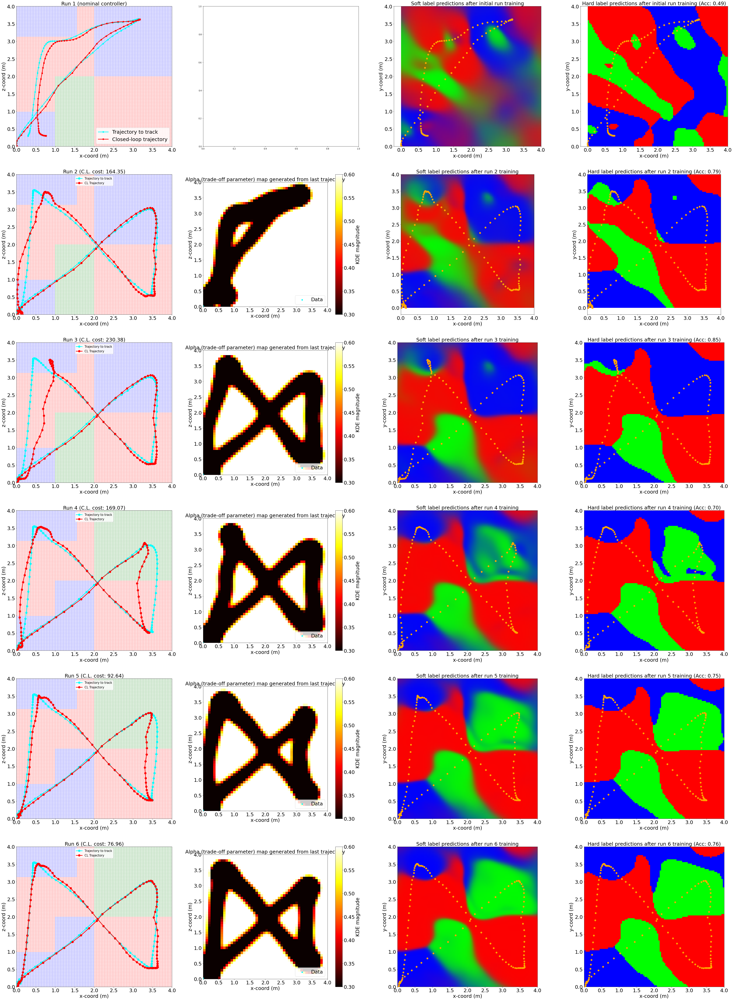

In [34]:
Q_override = np.eye(6)
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01

adap_pipeline.gpmpc_That_controller(init_traj_file="quad2d_dt50msN100disc100xz4_interiortrack_AIA_initial",
                                       rep_traj_file="quad2d_dt50msN100disc160xz4_interiortrack_AIA_rep",
                                    box_env_gen_fn=adap_utils.get_testmap_tensor_initial, new_box_env_gen_fn=adap_utils.get_testmap_tensor_adaptive2,
                                       satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((6, 1)), N=100, online_N=30,
                                       num_discrete=160, simulation_length=160, velocity_override=5, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                                       collision_check=True, verbose=False,
                                       sampling_time=50 * 1e-3,
                                       num_mapping_updates=5,
                                       Q_override=Q_override, R_override=R_override, siren_mapper=True, num_init_training_steps=75, num_rep_training_steps=50,
                                       viz_samples_on_test_pred=True,  kde_bw=0.15,  alpha_min=0.3, alpha_max=0.6, fixed_delta=True,
                                    siren_omega=5, num_runs=1, cost_save_file="test", run_num_offset=200, mode_switch_run_idx=4)

## Proposed solution demo (variable discrete variables across horizon)

Nominal MPC traj to warmstart and track solved.
Accuracy of GP predictions on train_ds by argmax: 0.88
Cross entropy loss of GP predictions on train_ds: 0.11227219575382748
Step 0, Total loss 145.948036
Step 40, Total loss 138.209213
PRED ACC 0.4563; PRED MSE 0.22883363617724353
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.18461 0.22247] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.2222  0.22247] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22235 0.21102] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22196 0.20902] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22169 0.21504] Solvi

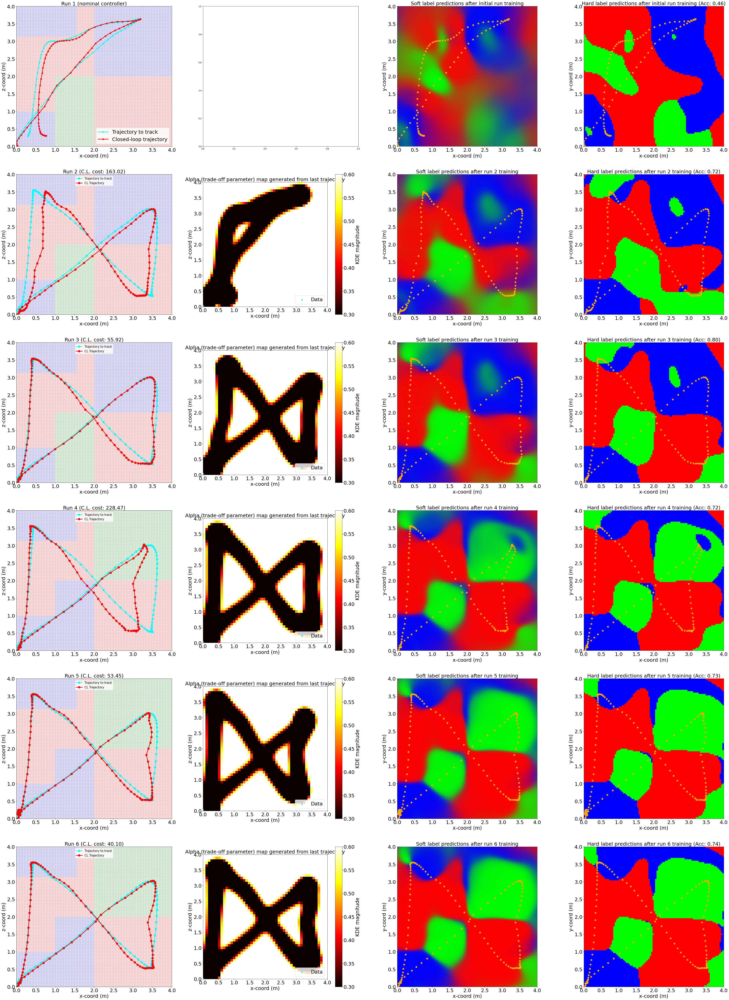

In [35]:
Q_override = np.eye(6)
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01

adap_pipeline.gpmpc_That_controller(init_traj_file="quad2d_dt50msN100disc100xz4_interiortrack_AIA_initial",
                                       rep_traj_file="quad2d_dt50msN100disc160xz4_interiortrack_AIA_rep",
                                    box_env_gen_fn=adap_utils.get_testmap_tensor_initial, new_box_env_gen_fn=adap_utils.get_testmap_tensor_adaptive2,
                                       satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((6, 1)), N=100, online_N=30,
                                       num_discrete=160, simulation_length=160, velocity_override=5, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                                       collision_check=True, verbose=False,
                                       sampling_time=50 * 1e-3,
                                       num_mapping_updates=5,
                                       Q_override=Q_override, R_override=R_override, siren_mapper=True, num_init_training_steps=75, num_rep_training_steps=50,
                                       viz_samples_on_test_pred=True,  kde_bw=0.15,  alpha_min=0.3, alpha_max=0.6, fixed_delta=False,
                                    siren_omega=5, num_runs=1, cost_save_file="test", run_num_offset=200, mode_switch_run_idx=4)

## Ablation for trade-off

Nominal MPC traj to warmstart and track solved.
Accuracy of GP predictions on train_ds by argmax: 0.8933333333333333
Cross entropy loss of GP predictions on train_ds: 0.10718344730270013
Step 0, Total loss 146.696301
Step 40, Total loss 137.767539
Step 80, Total loss 135.621771
Step 120, Total loss 134.636532
PRED ACC 0.4973; PRED MSE 0.22732354273701275
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.18531 0.22238] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.2221  0.22206] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22192 0.21111] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22098 0.20827] Solving for timestep: 4
t: 4, R

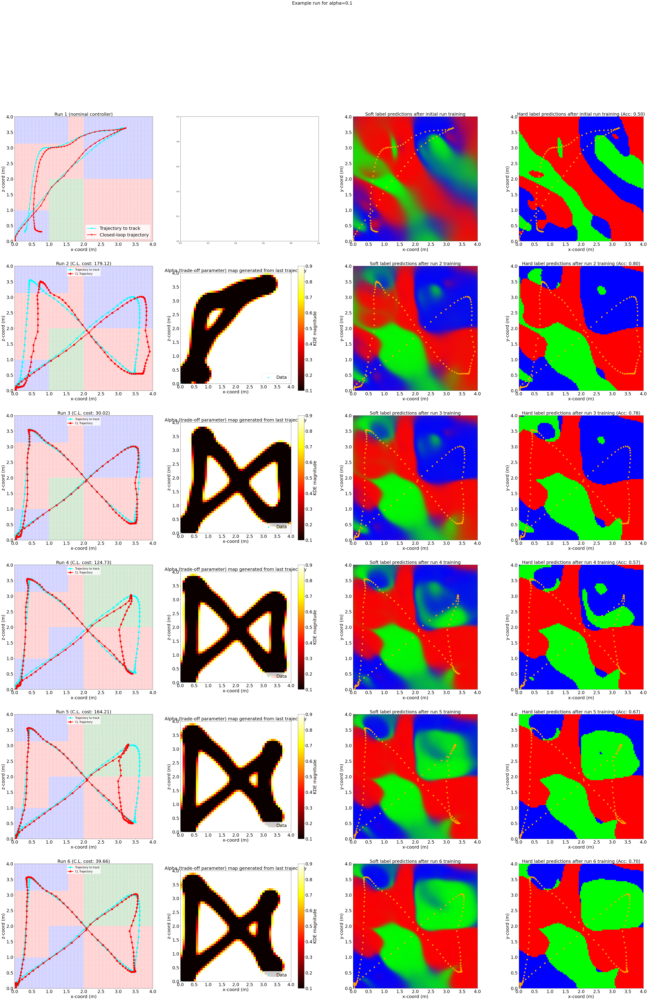

Nominal MPC traj to warmstart and track solved.
Accuracy of GP predictions on train_ds by argmax: 0.92
Cross entropy loss of GP predictions on train_ds: 0.06925609829430295
Step 0, Total loss 146.997266
Step 40, Total loss 136.556460
Step 80, Total loss 135.009372
Step 120, Total loss 134.225229
PRED ACC 0.5139; PRED MSE 0.21515613986501012
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.18569 0.22247] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22142 0.2222 ] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.2224 0.2117] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22145 0.20776] Solving for timestep: 4
t: 4, Ret. stat.: Solve

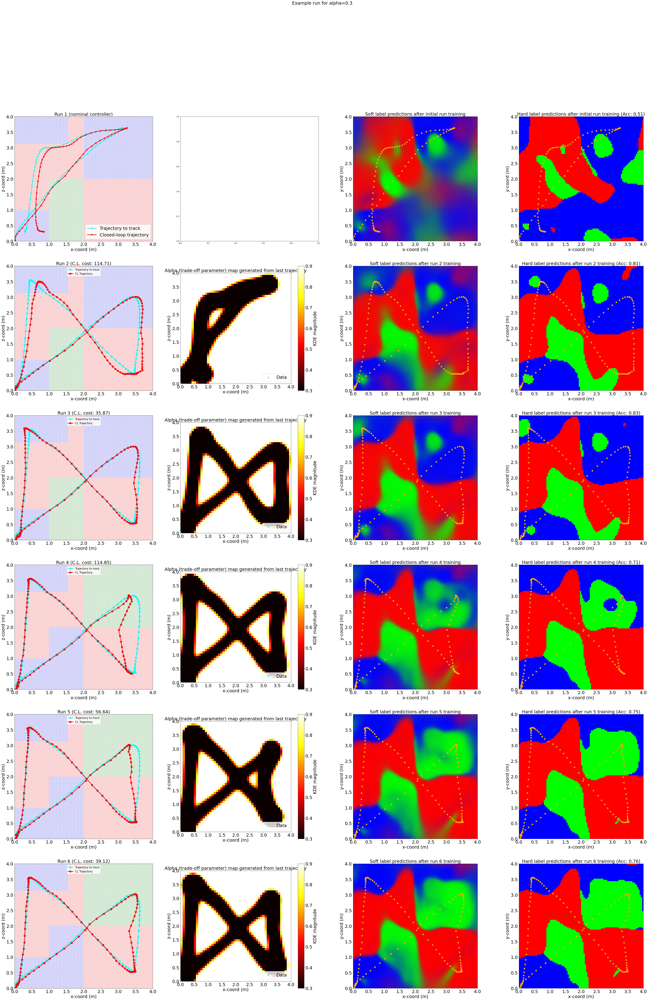

Nominal MPC traj to warmstart and track solved.
Accuracy of GP predictions on train_ds by argmax: 0.8733333333333333
Cross entropy loss of GP predictions on train_ds: 0.10001003148130748
Step 0, Total loss 146.561057
Step 40, Total loss 138.482896
Step 80, Total loss 136.585785
Step 120, Total loss 135.617205
PRED ACC 0.5912; PRED MSE 0.18800381215040649
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.18353 0.22246] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22238 0.22215] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.2224  0.21136] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22216 0.2076 ] Solving for timestep: 4
t: 4, R

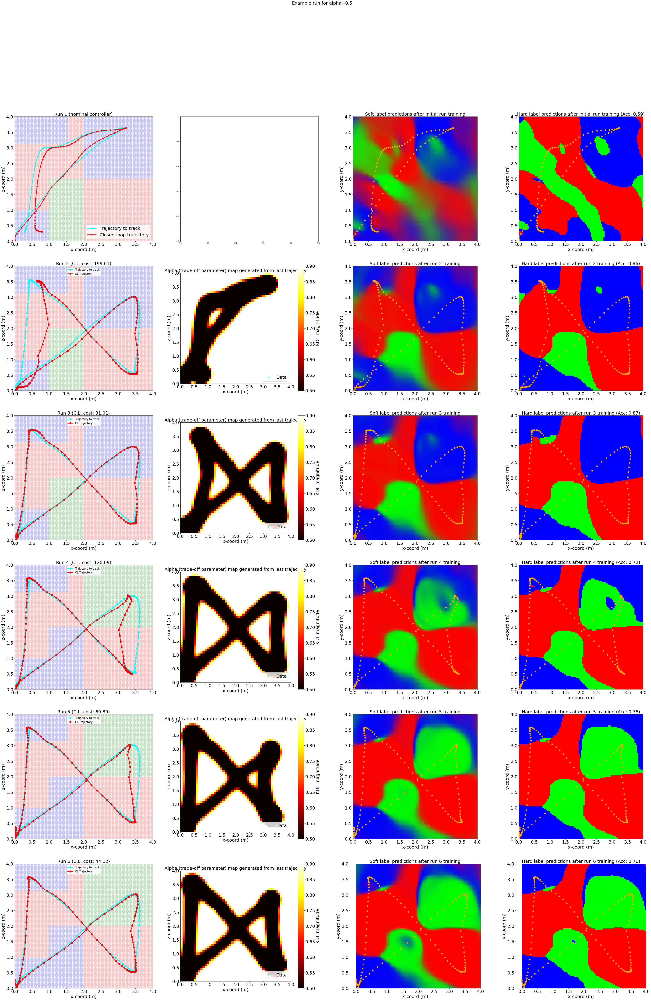

Nominal MPC traj to warmstart and track solved.
Accuracy of GP predictions on train_ds by argmax: 0.8533333333333334
Cross entropy loss of GP predictions on train_ds: 0.10259777279192883
Step 0, Total loss 146.877015
Step 40, Total loss 136.972446
Step 80, Total loss 135.380153
Step 120, Total loss 134.509235
PRED ACC 0.4529; PRED MSE 0.24408601819749273
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.18547 0.22249] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22174 0.22251] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22242 0.21127] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.22159 0.2087 ] Solving for timestep: 4
t: 4, R

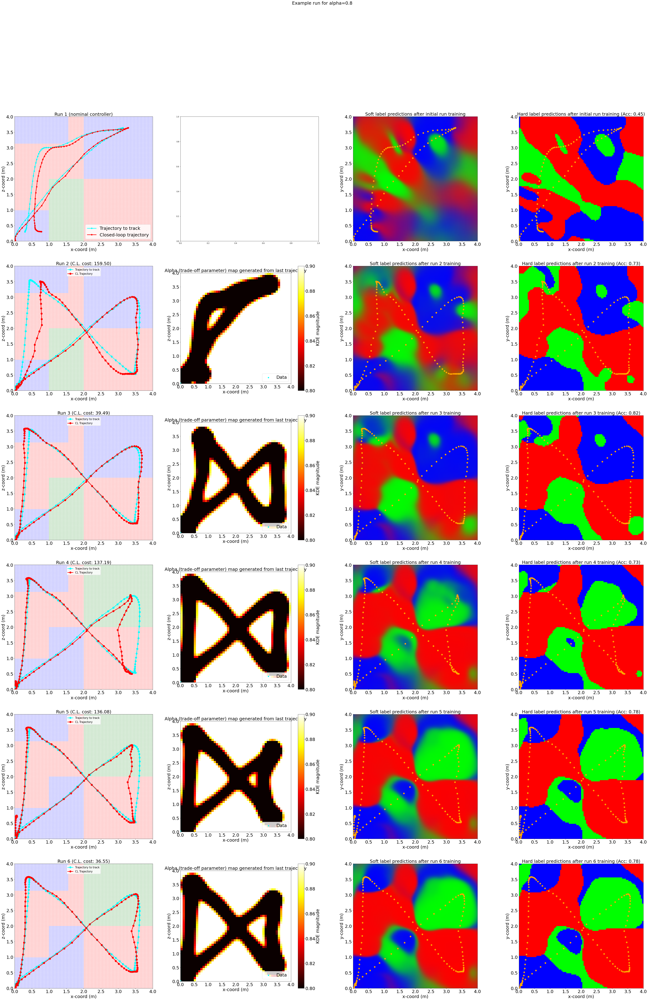

In [36]:
alpha_min_arr = [0.1, 0.3, 0.5, 0.8]
# alpha_min_arr = [0.8]

adap_pipeline.alpha_tradeoff_ablation_test(ds_inst_in=ds_inst_in, pw_gp_wrapped=pw_gp_wrapped, alpha_min_arr=alpha_min_arr, num_runs_per_alpha=1, 
                                           mode_switch_run_idx=4, num_mapping_updates=5, run_num_offset=105)